In [142]:
import numpy as np

import pandas as pd
import pandas_profiling

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

from typing import Tuple

In [3]:
# Read data
df = pd.read_csv('Bias_correction_ucl.csv')

# Explarotary Data Analysis (EDA)

## Data Overview

In [4]:
# First 5 rows of the data
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [5]:
# Summary statistics
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7750.000000,7682.000000,7682.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,...,7677.000000,7677.000000,7677.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7725.000000,7725.000000
mean,13.000000,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,0.368774,...,0.485003,0.278200,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220
std,7.211568,2.969999,2.413961,14.668111,7.192004,2.947191,2.345347,2.183836,33.730589,0.262458,...,1.762807,1.161809,1.206214,0.050352,0.079435,54.279780,1.370444,429.158867,3.128010,2.487613
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,...,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,45.963543,84.222862,27.673499,22.089739,5.678705,37.266753,0.146654,...,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,0.315697,...,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.190056,93.743629,31.710450,25.152909,8.032276,84.223616,0.575489,...,0.018364,0.007896,0.000041,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,...,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


In [6]:
# Data dtypes
df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

In [7]:
# Number of rows & cols
num_rows, num_cols = df.shape

# Columns with missing values
null_cols = set(df.columns[df.isnull().any()])

# Columns with no missing values
no_null_cols = set(df.columns) - null_cols

# Number of missing values in each column
null_size = df.isnull().sum()

print(f'The data has {num_rows} rows and {num_cols} columns\n')
print(f'The columns NOT containing missing values are: {no_null_cols}\n')
print(f'The number of missing values in each column:\n{null_size}')

The data has 7752 rows and 25 columns

The columns NOT containing missing values are: {'DEM', 'lon', 'lat', 'Slope', 'Solar radiation'}

The number of missing values in each column:
station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64


## Data Profiling

The following generates a comprehensive, quick, and interactive report about the data. It includes summary statistics about the data, histograms of individual variables, correlation matrix, and analysis of missing values. 

*Note*: during the EDA process, some steps that are generated by pandas_profiling will be generated manually again for a step by step analysis and explanation. 

In [8]:
profile = pandas_profiling.ProfileReport(df, explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Exploring Zeros

Columns who have >10% of the data as zeros are:
{'LDAPS_PPT4', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT1'}


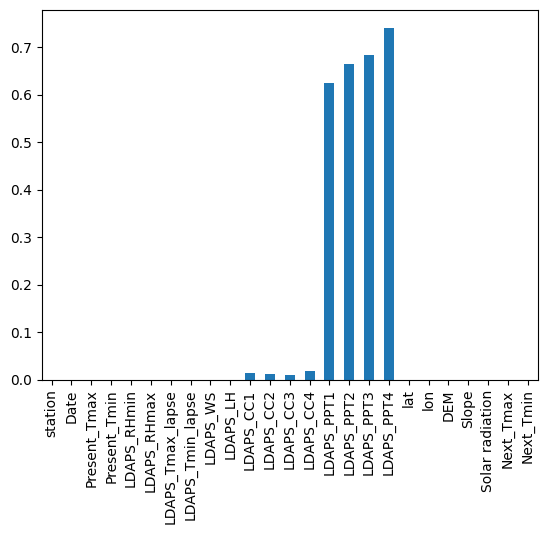

In [9]:
# Ratio of zeros in all columns
zero_ratios = (df == 0).mean()

# Columns who have 10% or more of their values as zero
high_zero_columns = set(df.columns[zero_ratios >= 0.1])

zero_ratios.plot(kind='bar')
print(f'Columns who have >10% of the data as zeros are:\n{high_zero_columns}')

More than 60% of the LDAPS model forecast of the 4 split average precipitation values are zeros. This suggests that these 4 columns must be removed from the data. 

## Exploring Missing Values

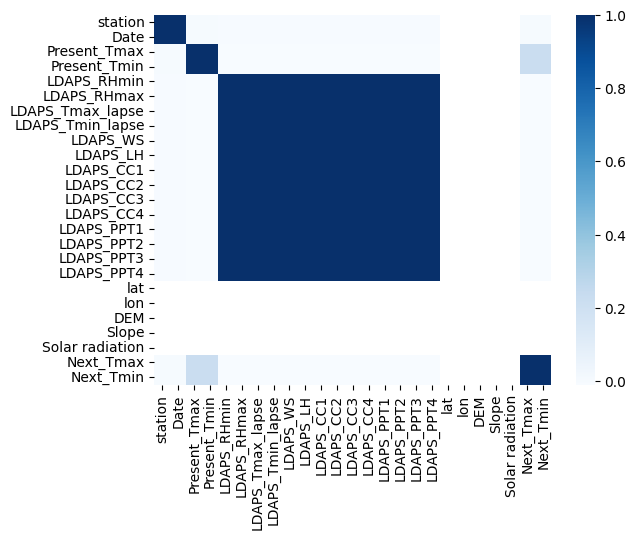

In [10]:
# Generate a heatmap for the correlation of the missing valus in the data
fig = sns.heatmap(df.isnull().corr(), cmap='Blues')

### Date and station

The Date and station columns have two missing values. The missing values correlation heatmap suggest that the missing values from both columns perfectly coincide with each other, however all the other variables have valid information for these two entities. Let's explore more to see where these missing values happen.

In [11]:
# The indices of the rows that have missing dates and stations
null_dates_rows = df[df['Date'].isnull()].index.to_list()
 
# The dates of the last 27 measurements 
last_27_dates = df.iloc[-27:]['Date'].value_counts()

print(f'The rows indices of the missing dates are: {null_dates_rows}, which are the last two rows\n')
print(f'The dates of the last 27 measurements are:\n{last_27_dates}')

The rows indices of the missing dates are: [7750, 7751], which are the last two rows

The dates of the last 27 measurements are:
2017-08-30    25
Name: Date, dtype: int64


The last 27 measurements contain only one date with 25 values. Hence, it is obvious that these missing information come from a new day for which only two measurements out of the 25 stations are available. This suggests the removal of these two entities. 

### In-situ Measurements & LDAPS Predictions 

The missing values correlation heatmap suggests that all the LDAPS missing values perfectly coincide with each other. The same is true for Present_Tmax & Present_Tmin (in-situ observations). However, missing values from in-situ observations and LDAPS predictions never coincide. 

Next it would be helpful to know from which dates and stations are these values missing to have a better understanding if there is a pattern in the nature of the missing values. 

In [12]:
# Dates which contain missing values for Present_Tmax and Present_Tmin
null_insitu_dates = df[df['Present_Tmax'].isnull()].groupby('Date').size()

# Stations which contain missing values for Present_Tmax and Present_Tmin
null_insitu_stations = df[df['Present_Tmax'].isnull()].groupby('station').size()

# Dates which contain missing values from the LDAPS model predictions
null_LDAPS_dates = df[df['LDAPS_Tmax_lapse'].isnull()].groupby('Date').size()

# Stations which contain missing values from the LDAPS model predictions
null_LDAPS_stations = df[df['LDAPS_Tmax_lapse'].isnull()].groupby('station').size()

print(f'The number of days that do not have in-situ observation values are: {null_insitu_dates.size}')
print(f'The number of stations that do not have in-situ observation values are: {null_insitu_stations.size}\n')

print(f'The number of days that do not have LDAPS prediction values are: {null_LDAPS_dates.size}')
print(f'The number of stations that do not have LDAPS prediction values are: {null_LDAPS_stations.size}')

The number of days that do not have in-situ observation values are: 56
The number of stations that do not have in-situ observation values are: 19

The number of days that do not have LDAPS prediction values are: 3
The number of stations that do not have LDAPS prediction values are: 25


The answer to the previous questions suggest that the missing in-situ measurements happen at random times from different stations. However, the missing LDAPS values are missing from only 3 days but from all the stations.

### Target Variables

The missing values heatmap shows that the missing values of both target variables coincide perfectly with each other. In addition, these missing values also correlate with the in-situ measurement values.

In [13]:
# Dates which contain missing target variables which don't coincide with missing in-situ measurements
null_target_dates = df[df['Next_Tmax'].isnull() & ~df['Present_Tmax'].isnull()].groupby('Date').size()

# Stations which contain missing target variables which don't coincide with missing in-situ measurements
null_target_stations = df[df['Next_Tmax'].isnull() & ~df['Present_Tmax'].isnull()].groupby('station').size()

print(f'The number of days that do not have target values are: {null_target_dates.size}')
print(f'The number of stations that do not have target values are: {null_target_stations.size}')

The number of days that do not have target values are: 16
The number of stations that do not have target values are: 11


## Exploring the Data Visually

### Correlation Matrix

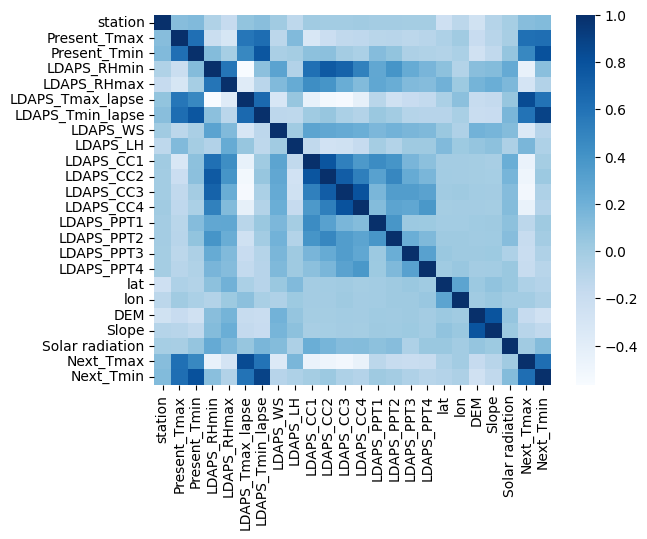

In [14]:
fig = sns.heatmap(df.corr(), cmap='Blues')

### Histograms

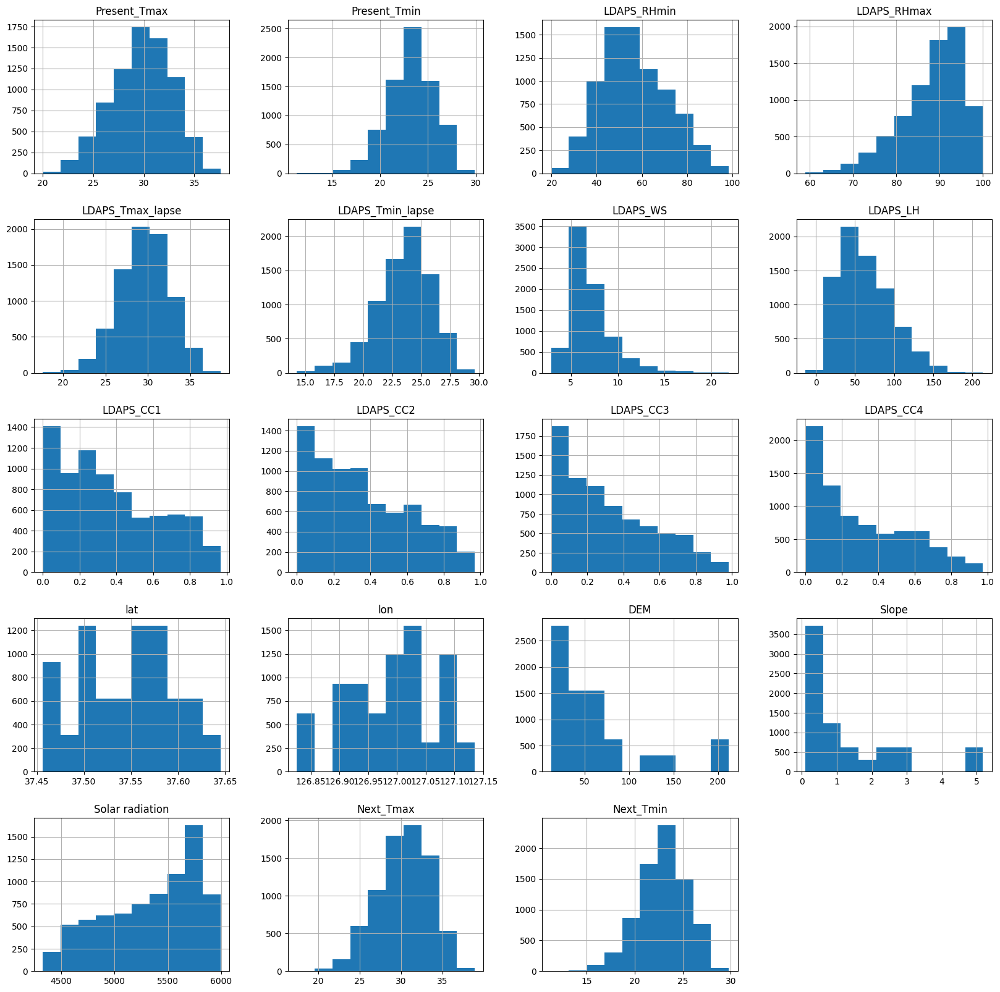

In [15]:
exclude_columns = ['station', 'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4']
fig = df.loc[:, ~df.columns.isin(exclude_columns)].hist(figsize=(20,20))

### Years Bar Plot

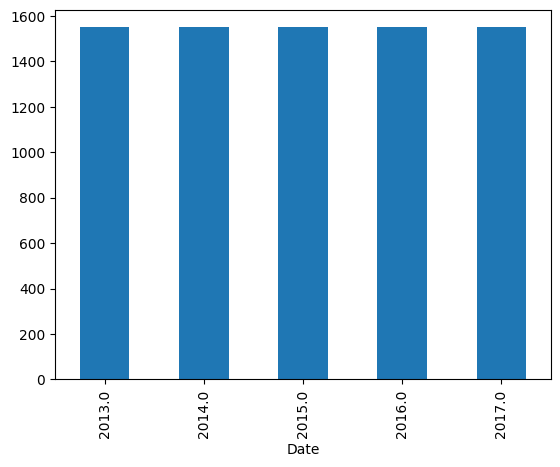

In [16]:
# Check the data distribution across the years
years = df.groupby(df['Date'].apply(pd.to_datetime).dt.year).size().plot(kind='bar')

### Months Bar Plot

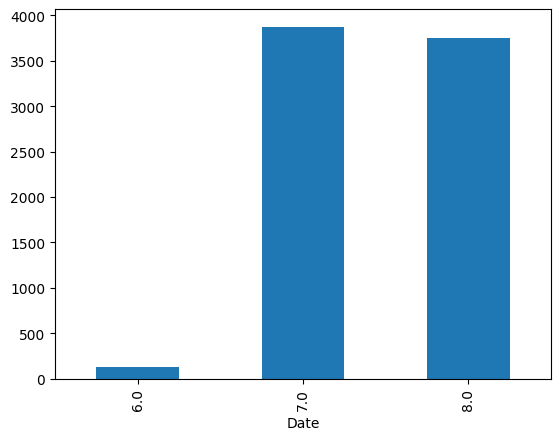

In [17]:
# Check the data distribution across the months
years = df.groupby(df['Date'].apply(pd.to_datetime).dt.month).size().plot(kind='bar')

## Coordinates Bar Plot

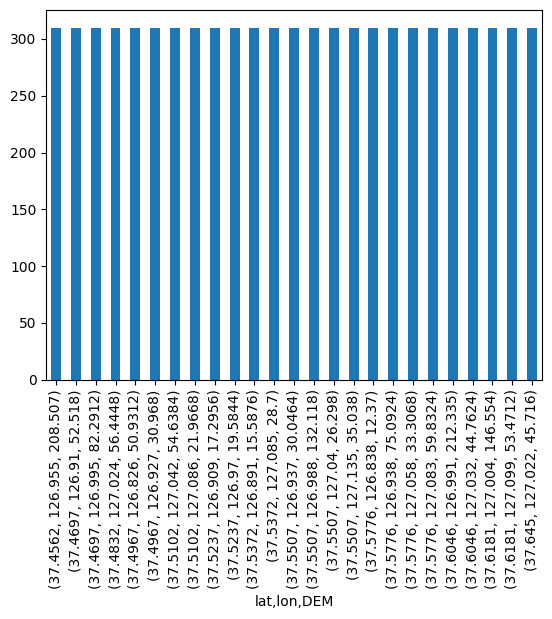

In [18]:
# Group by coordinates and remove the last two rows that contain missing station numbers
coordinates = df.iloc[:-2].groupby(['lat', 'lon', 'DEM']).size().plot(kind='bar')

The coordinates group into 25 groups that distribute unfifromly across the days, which means that one can use these coordinates to describe the location of the 25 stations. Hence, the station variable can be removed from the data and maybe used as an index.

# Data Preprocessing

In [49]:
def preprocess_data(df: pd.DataFrame) -> Tuple[pd.DataFrame, pd.DataFrame]:
    """Function that takes as input the raw data of Bias_correction_ucl.csv as a dataframe, 
    applies steps of preprcoessing and cleaning, then returns the independent and dependent (target) variables 
    in separate dataframes. 
    
    Preprocessing steps are:
        1. Remove the 4 LDAPS_PPT columns since they contain high proportion of zeros
        2. Remove the last two rows because they have missing data and station numbers
        3. Remove all rows that have missing target variables
        4. Remove all rows that have missing in-situ measurements
        5. Remove all rows that have missing LDAPS measurements
        6. Convert the data from string into datetime format, and the station from float into int
        7. Set Date and station as a multi-index of the data and extract target variables
        
    Args:
        df: dataframe of the raw data
        
    Returns: X, y as independent and dependent variables, respectively
    
    """
    
    target_vars = ['Next_Tmin', 'Next_Tmax']
    
    # Step 1
    df = df.drop(df.columns[df.columns.str.contains('PPT')], axis=1)
    
    # Step 2
    df = df.iloc[:-2]
    
    # Step 3 - Step 5 can be done in one step since we are considering all the columns that have Null values
    df = df.dropna(axis=0, how='any')
    
    # Step 6
    df['Date'] = pd.to_datetime(df['Date'])
    df['station'] = df['station'].apply(int)
    
    # Step 7
    df = df.set_index(['Date', 'station'])
    
    X, y = df.drop(target_vars, axis=1), df[target_vars]
    
    return X, y

# Apply data preprocessing
X, y = preprocess_data(df)

# Data Validation

In [50]:
# Test the number of columns
assert len(X.columns) == 17 # 25 - 2(target variables) - 4(LDASP_PTT) - 2(Date & station)
assert len(y.columns) == 2 # Next_Tmin & Next_Tmax

# Test the number of rows
assert X.shape[0] == y.shape[0] 

# Test type of the Data index
assert type(X.index.get_level_values(0)) == pd.core.indexes.datetimes.DatetimeIndex

# Test if there are no Null values
assert  X.isnull().all(axis=0).all() == False

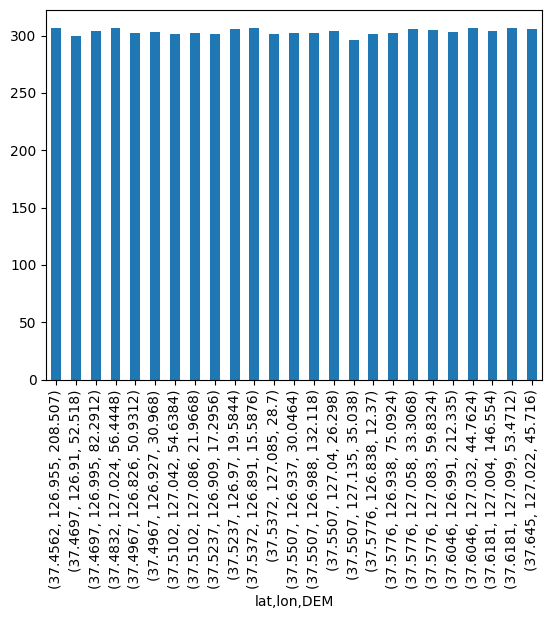

In [51]:
# Visualize the distribution of the station after removing Null
coordinates = X.iloc[:-2].groupby(['lat', 'lon', 'DEM']).size().plot(kind='bar')

The distribution of the stations after removing Null values is not uniform anymore. This means that there are different number of entities for each day present in the dataset. 

Some stations are represented more than the others. This needs to be taken in consideration when the evaluation results are interpreted. 

# Data Segregation

The data here will be segregated into train and test sets, where the test set contains data from the last year. 
It is important to note here that this kind of evaluation is biased to some extent since the models will be only evaluated on a specific year. 

For better evaluation, one could evaluate the data in a time-based cross-validation manner, however this kind of validation in this assignment will be used for hyper-parameter tuning. 

As an improvement and in an attempt to combine both, one could implement a nested cross-validation where in each split the data is divided into train, validation, and test in a time-based manner. In this case one could evaluate the data on different time sequences and still be able to hyper-paramter tune the ML models without data leackage. However, for this assignment the models will be evaluated on the test set while cross-validation will be used for tuning the hyper-parameters.

In [52]:
def train_test_split(X: pd.DataFrame, y: pd.DataFrame) -> Tuple[pd.DataFrame]: 
    years_groups = X.groupby(X.index.get_level_values(0).year).size()

    train_idxs = np.where(X.index.get_level_values(0).year != years_groups.index[-1])
    test_idxs = np.where(X.index.get_level_values(0).year == years_groups.index[-1])
    
    X_train = X.iloc[train_idxs]
    y_train = y.iloc[train_idxs]
    
    X_test = X.iloc[test_idxs]
    y_test = y.iloc[test_idxs]
    
    return X_train, y_train, X_test, y_test

# Apply data segregation
X_train, y_train, X_test, y_test = train_test_split(X, y)

# Feature Importance & Dimensionality Reduction

This step is made to have a better understanding of the features we have in the training data and what features could be contributing best to the ML models. This will also help to decide if dimensionality reduction or feature selection will be required in the pipeline. 

It is important to note here that this step will not apply feautre selection or dimensionality reduction yet. These steps, if necessary, will be added as part of the ML pipeline to prevent any data leackage during cross-validation. 

In [109]:
from sklearn.feature_selection import r_regression, mutual_info_regression
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler

## Mutual Information

Mutual information between independent variables and target variables gives an idea which features are the most discriminative ones for these target variables.

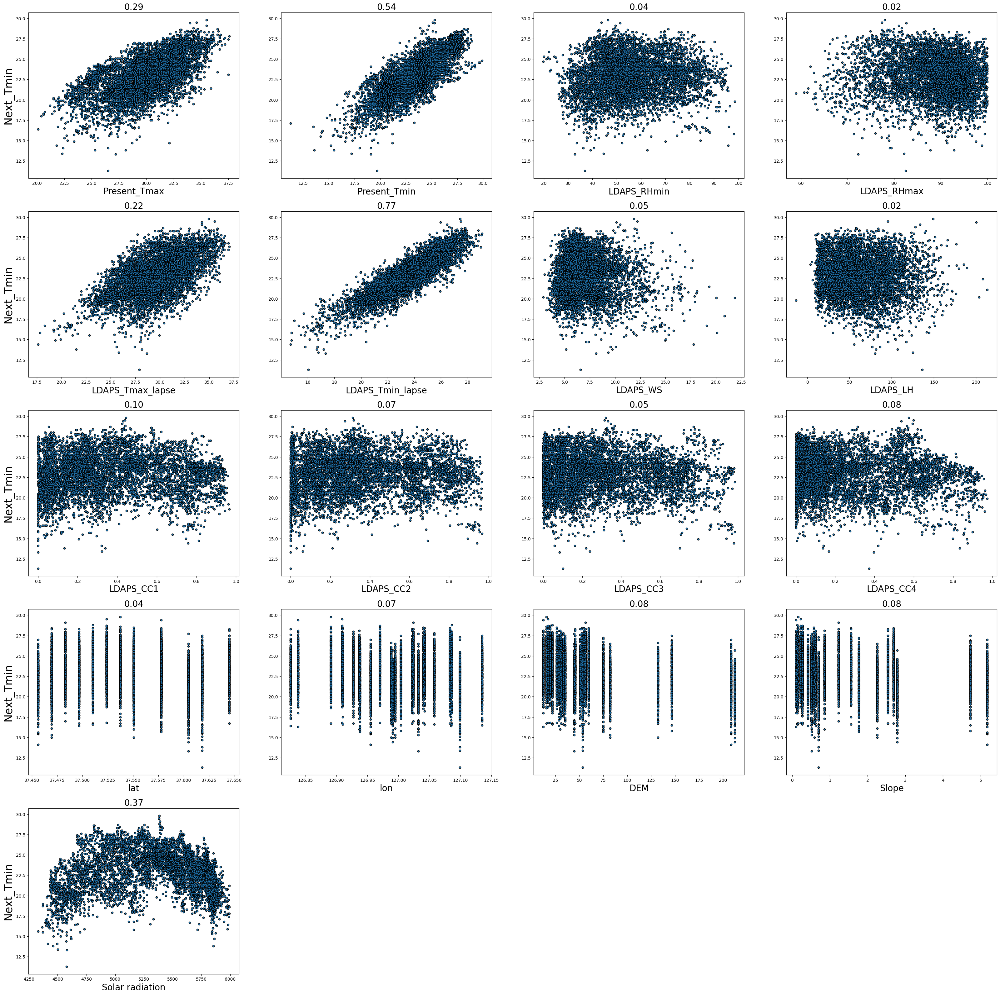

In [137]:
# Mutual information between each feature in X_train and the Next_Tmin
mi_Tmin = mutual_info_regression(X_train, y_train.iloc[:,0])

fig = plt.figure(figsize=(40,40))
for i in range(17):
    plt.subplot(5, 4, i + 1)
    plt.scatter(X_train.iloc[:, i], y_train.iloc[:,0], edgecolor="black", s=20)

    plt.xlabel(f'{X.columns[i]}', fontsize=20)
    if i % 4 == 0:
        plt.ylabel('Next_Tmin', fontsize=25)
        
    plt.title(f'{mi_Tmin[i]:0.2f}', fontsize=20)

Mutual information ranks LDAPS_Tmin_lapse and Present_Tmin feature as the most discriminative features for Next_Tmin. Solar radiation, Present_Tmax, and LDAPS_Tmax_lapse come next. The other feature have small mutual infromation with the target variable, which suggest feature selection techniques are required to add to the pipeline. 

## Principal Component Analysis (PCA)

This is just to show if we would apply PCA to the data, how many components we would need to explain 95% of the variance of the data. 

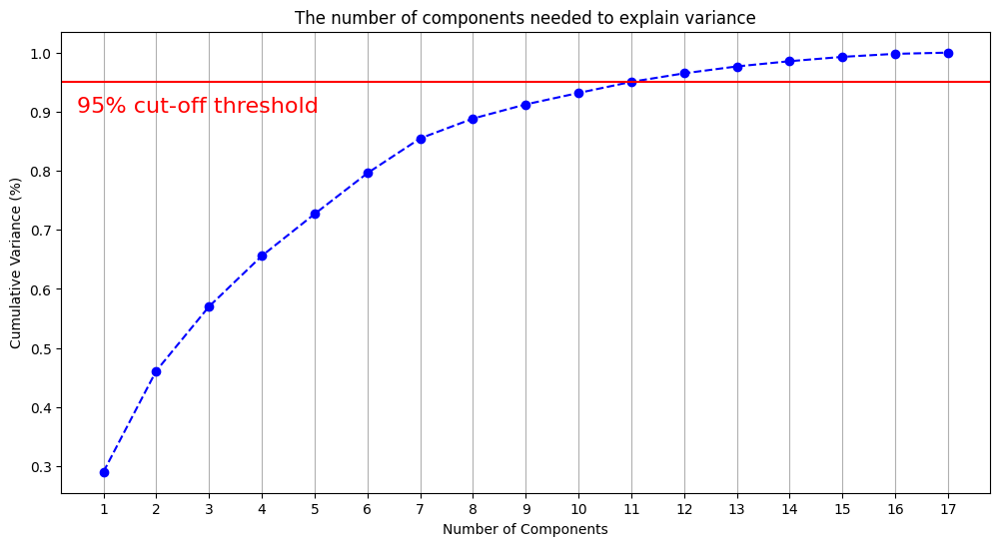

In [131]:
# Rescale the data between 0 and 1
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)

# Apply PCA
pca = PCA().fit(X_train_scaled)

# Find the cumulative variance explained by PCA components
cum_var = np.cumsum(pca.explained_variance_ratio_)

# Creat figure
fig, ax = plt.subplots()#

# Figure x-axis
num_comp = np.arange(1, 18)

# Plot cumulative variance vs. number of components
plt.plot(num_comp, cum_var, marker='o', linestyle='--', color='b')

# Add labels and title
plt.xticks(np.arange(1, 18)) 
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Variance (%)')
plt.title('The number of components needed to explain variance')

# Draw a horizontal line 
plt.axhline(y=0.95, color='r', linestyle='-')
plt.text(0.5, 0.9, '95% cut-off threshold', color = 'red', fontsize=16)

# Draw grid
ax.grid(axis='x')

We would need 11 PCA components to explain 95% of the data.

Even though this would help in reducing the number of features, in the pipeline we will use feature selection instead of dimensionality reduction to reduce the number of the features because this will help keep the interpretibility of the features when we later analyize the ML models. In addition, the analysis of mutual information shows that simple techniques can be used to select those features that can better discriminate the target variable. 

# ML Pipeline

## Custom Metrics

In [159]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import make_scorer

In [161]:
def bias(y_true: np.ndarray, y_pred: np.ndarray) -> float:
    return (y_pred - y_true).mean()

def RMSE(y_true: np.ndarray, y_pred: np.ndarray) -> float:
    return np.sqrt(mean_squared_error(y_true, y_pred))

# Scoring dictionary consists of all the scoring methods that will be used
scoring = {'Bias': make_scorer(bias),
           'RMSE': make_scorer(RMSE),
           'R2': make_scorer(r2_score)}

## Custom Validation Functions

In [149]:
class HindcastCV:
    """A class that implements Hincast validation across the years. 
    
    Unlike what is mentioned in the paper, this class applies Hindcast validation yearly, instead of daily. 
    The reason behind that is the need of a more efficient fuction in order to allow hyper-parameter tuning of
    the ML models. In additon, the nature of this data has a yearly pattern, which makes this function suitable
    for testing the generalization of the ML models across years. 
    
    This class has a generator that yields the train and test indices of different splits.

    """
    @classmethod
    def split(cls, X: pd.DataFrame):
        """This method generates indices of train and test sets after splitting the data into successive years.
        At each split, the train set contains measurements from the firt year until the year that meets
        the current split, wheras the test set contains measurment from the next year. 
        The last year is only included in the test set.
        
        The method assumes a pandas dataframe as input with a multi-index, where the first index is the
        date in the datetime format.
        
        Args:
            X: data of independent variables
        
        """
        
        # Find the group of years and the number of measurements for each year
        years_groups = X.groupby(X.index.get_level_values(0).year).size()
        
        # Accumlative train size increses with each split
        train_size = 0 
        
        for split, (year, year_size) in enumerate(years_groups.items()):
            train_size += year_size  # train_size - 1 = row index of last training sample
            
            train_idx = np.arange(train_size)  
            test_idx = np.where(X.index.get_level_values(0).year == year + 1)[0]
                    
            if split == len(years_groups) - 1:
                break
            
            yield train_idx, test_idx

            
class LOSOCV:
    """A class that implements Leave-One-Station-Out validation, which can be used to test the generalization
    of the ML models across different stations.
    
    This class implements a generator that yields the train and test indices of different splits.
    
    """
    
    @classmethod
    def split(cls, X: pd.DataFrame):
        """This method generates indices of train and test sets after splitting the data into different
        stations. At each split, the test set contains measurements from a unique station across all years, 
        whereas the train set contains the measurements from all other stations. 
        
        The method assumes a pandas dataframe as input with a multi-index, where the second index is the 
        station number.
        
        Args:
            X: data of independent variables 
        
        """
        
        # Find the group of stations and the number of measurements for each station
        stations_groups = X.groupby(X.index.get_level_values(1)).size()
        
        for station, _ in stations_groups.items():
            train_idx = np.where(X.index.get_level_values(1) != station)[0]
            test_idx = np.where(X.index.get_level_values(1) == station)[0]
            
            yield train_idx, test_idx

## Transformers pipeline

The transformation steps that will be added to the pipeline are feature selection and standardization. Composing these into a pipeline helps in ensuring that there is NO data leackage during from validation sets or test sets into training sets. 

In [152]:
from sklearn.feature_selection import SelectKBest, mutual_info_regression
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

In [154]:
# Create a pipeline with two transformers: feature selection and standardization 
pipeline = Pipeline(steps=[
    ('feature_selector', SelectKBest(score_func=mutual_info_regression, k='all')),
    ('scaler', StandardScaler())
])

## Estimators

### Random Forest

In [155]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier